In [ ]:
!pip install dash-core-components
!pip install dash

     |████████████████████████████████| 3.5MB 5.9MB/s 
  Created wheel for dash-core-components: filename=dash_core_components-1.15.0-cp37-none-any.whl size=3527014 sha256=70aed31231eb11c0a504e8ca52a6da9f5e17715f96e838615acbfce896cf8679
  Stored in directory: /root/.cache/pip/wheels/53/3d/be/d628d6f66eedf9597f0c89c8ff43a5020ad1c25152c77d8e9f
Successfully built dash-core-components
     |████████████████████████████████| 81kB 3.2MB/s 
     |████████████████████████████████| 1.0MB 6.0MB/s 
     |████████████████████████████████| 194kB 13.1MB/s 
     |████████████████████████████████| 1.8MB 13.2MB/s 
     |████████████████████████████████| 358kB 31.0MB/s 
  Created wheel for dash: filename=dash-1.19.0-cp37-none-any.whl size=84011 sha256=88a97a6e08cbb91ca540eec015dbc6313da792374186cfa021356a1e0bde973c
  Stored in directory: /root/.cache/pip/wheels/f7/50/a7/a230ff7f503b10120bff18c2524a375bb85a61ce6b519c8a77
  Created wheel for flask-compress: filename=Flask_Compress-1.9.0-cp37-none-any.whl 

**Import and Preprocessing**

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt 
import scipy as sp
from scipy import pi 
from scipy import signal
from scipy.fftpack import fft
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import numpy as np
import dash_core_components as dcc
from tensorflow import keras
import seaborn as sns

from keras.optimizers import Adam

In [ ]:
plt.rcParams['figure.figsize'] = (10,5)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# our shared folder is /content/drive/My Drive/Major_Project 
import os
os.chdir('/content/drive/My Drive/Major Project')

In [ ]:
df = pd.read_csv('TUE_feb09.txt', skiprows = 1, sep ='\t')

In [ ]:
df

,address,Time(s),ax(g),ay(g),az(g),AngleX(deg),AngleY(deg),AngleZ(deg),T(°)
0,0x50,16:14:15.651,-0.0068,0.0005,1.0020,-0.0494,0.0714,-0.2747,31.24
1,0x50,16:14:15.651,-0.0083,-0.0068,1.0015,-0.0494,0.0714,-0.2747,31.11
2,0x50,16:14:15.651,0.0054,-0.0088,1.0015,-0.0494,0.0714,-0.2747,31.18
3,0x50,16:14:15.682,0.0068,-0.0063,1.0005,-0.0494,0.0714,-0.2747,30.86
4,0x50,16:14:15.698,0.0078,-0.0044,1.0029,-0.0494,0.0659,-0.2747,31.05
...,...,...,...,...,...,...,...,...,...
64043,0x50,16:35:38.969,-0.0039,-0.0127,1.0015,-0.5658,0.3735,1.3129,33.51
64044,0x50,16:35:39.047,-0.0107,-0.0073,0.9985,-0.5658,0.3735,1.3129,33.51
64045,0x50,16:35:39.047,-0.0078,-0.0161,0.9971,-0.5658,0.3735,1.3129,33.58
64046,0x50,16:35:39.047,-0.0103,-0.0049,0.9980,-0.5658,0.3735,1.3074,33.51


In [ ]:
def addDate(dframe,date_string):

  dframe = date_string + dframe;

  return dframe;


**DataFrame Preprocessing**

In [ ]:
df['Time(s)'] = addDate(df['Time(s)'], '2021-02-09')
df.index = df['Time(s)']
df.index = pd.to_datetime(df.index)
df = df.drop(columns=['address', 'Time(s)'])

In [ ]:
# # Calibration Went Wrong, So Shift To Zero

# df = df.iloc[:,:3]
# df_ay_mean = df['ay(g)'].mean()
# df_ay_mean
# df['ay(g)'] = df['ay(g)'] - df_ay_mean


In [ ]:
az = go.Scatter(x=df.index, y = df['az(g)'], name ="az")
ay = go.Scatter(x=df.index, y = df['ay(g)'], name="ay")
ax = go.Scatter(x=df.index, y = df['ax(g)'], name="ax")
 
figx = make_subplots(rows=3,cols=1)

figx.add_trace(ax,row=1,col=1)
figx.add_trace(ay,row=2,col=1)
figx.add_trace(az,row=3,col=1)


figx.show()

**Sampling Rate (Inconsistent)**

In [ ]:
# index_difference = df.index.to_series().diff().median().total_seconds()
# index_difference

# Fs = np.floor(1/index_difference)
# T = 1/Fs;
# print(index_difference)
# print(Fs)
# print(T)

**Data Extraction**

In [ ]:
#@title
def extract_data(df,start_time,end_time):
  
  extracted_data = df[(df.index >= start_time) & (df.index <= end_time)]
  
  return extracted_data;

In [ ]:
#@title
def calc_rms(data,window):

  length = len(data);
  
  n_steps = np.int(np.floor(length/window));

  data_rms = np.zeros((length,1));

  for i in range(0,n_steps):
    data_rms[i] = np.sqrt(np.mean(data[(i * window):((i +1) * window)] ** 2));    

  return data_rms;

In [ ]:
#@title
az_extract = extract_data(df['az(g)'],df.index[1],df.index[len(df)-1])
len(az_extract)
# plt.plot(nl_extract)

37712

**Stationarity and Correlation**

***Rolling Mean and Standard Deviation**

In [ ]:
#@title
rolling_mean = az_extract.rolling(20).mean()
rolling_std = az_extract.rolling(20).std()

#Plot rolling statistics
original = go.Scatter(x=az_extract.index,y=az_extract.values)
mean = go.Scatter(x=rolling_mean.index,y=rolling_mean.values, line=dict(color='chartreuse'))
std = go.Scatter(x=rolling_std.index,y=rolling_std.values, line=dict(color='black'))

figx = go.Figure(data = original)
figx.add_trace(mean)
figx.add_trace(std)

figx.show()



In [ ]:
#@title
fig = go.Figure(data=std)
fig.show()

In [ ]:
#@title
from statsmodels.tsa.stattools import adfuller
# Run Augmented Dickey Fuller Test
result = adfuller(az_extract)
# Print p-value
print(result[1])

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



2.068049879904683e-30


In [ ]:
#@title
# Plot ACF
from statsmodels.graphics.tsaplots import plot_acf


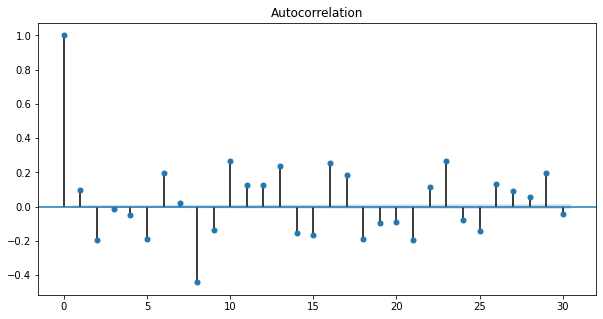

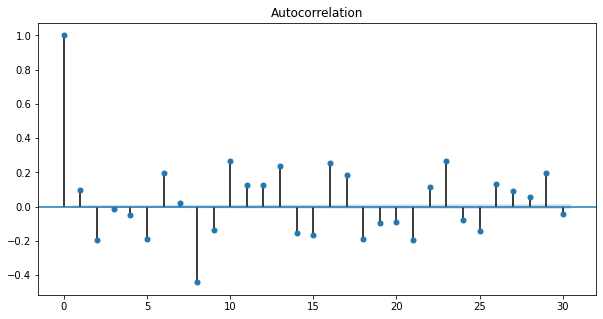

In [ ]:
#@title
plot_acf(az_extract.dropna(), lags=30, alpha=0.05)

**LSTM autoencoder**

In [ ]:
df1 = df.resample('20ms').mean()
df1 = df1.interpolate(method='polynomial', order=2)

#df1 = df1[(df1.index >= '2021-02-09 16:25:00.000') & (df1.index <= '2021-02-09 16:30:00.000')]
az = go.Scatter(x=df.index, y = df1['az(g)'], name ="az")
ay = go.Scatter(x=df.index, y = df1['ay(g)'], name="ay")
ax = go.Scatter(x=df.index, y = df1['ax(g)'], name="ax")
 
figx = make_subplots(rows=3,cols=1)

figx.add_trace(ax,row=1,col=1)
figx.add_trace(ay,row=2,col=1)
figx.add_trace(az,row=3,col=1)


figx.show()
from sklearn.ensemble import IsolationForest
df1

,ax(g),ay(g),az(g),AngleX(deg),AngleY(deg),AngleZ(deg),T(°)
Time(s),,,,,,,
2021-02-09 16:14:15.640,-0.003233,-0.005033,1.001667,-0.049400,0.071400,-0.274700,31.176667
2021-02-09 16:14:15.660,0.007941,-0.005611,1.003133,-0.049398,0.068395,-0.274694,30.988635
2021-02-09 16:14:15.680,0.007300,-0.005350,1.001700,-0.049400,0.068650,-0.274700,30.955000
2021-02-09 16:14:15.700,-0.002900,-0.004400,0.998000,-0.049400,0.071400,-0.274700,31.050000
2021-02-09 16:14:15.720,-0.009119,-0.003665,0.995835,-0.049364,0.072047,-0.274588,31.119060
...,...,...,...,...,...,...,...
2021-02-09 16:35:38.960,-0.003400,-0.015150,1.003200,-0.563050,0.376250,1.312900,33.575000
2021-02-09 16:35:38.980,-0.005011,-0.015187,1.003834,-0.561846,0.375036,1.311862,33.557315
2021-02-09 16:35:39.000,-0.006406,-0.014100,1.003246,-0.561674,0.374173,1.311057,33.559337


Train test split and standardization

In [ ]:
train_size = int(len(df1) * 0.7)

test_size = len(df1) - train_size

train, test = df1.iloc[0:train_size], df1.iloc[train_size:len(df1)]

# train = np.reshape(train,(train_size,1)) #Reshaping into (len,1)
# test = np.reshape(test,(test_size,1))


print(train.shape, test.shape)

(44919, 7) (19252, 7)


In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

scaler = scaler.fit(train[['az(g)']])

train['az(g)'] = scaler.transform(train[['az(g)']])

test['az(g)'] = scaler.transform(test[['az(g)']])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
seq_size = 40
def to_sequences(x,y,seq_size=1):
  x_values = []
  y_values = []
  
  for i in range(len(x)-seq_size):
    x_values.append(x.iloc[i:(i+seq_size)].values)
    y_values.append(y.iloc[i:(i+seq_size)])
    
  return np.array(x_values), np.array(y_values)

trainX, trainY = to_sequences(train[['az(g)']], train['az(g)'], seq_size)
testX, testY = to_sequences(test[['az(g)']], test['az(g)'], seq_size)
print(trainX.shape,testX.shape,trainY.shape,testY.shape)

(44879, 40, 1) (19212, 40, 1) (44879, 40) (19212, 40)


LSTM simple model for testing

In [ ]:
#implementing a model
model = keras.Sequential()
model.add(keras.layers.LSTM(

    units=64,

    input_shape=(trainX.shape[1], trainX.shape[2])

))

model.add(keras.layers.Dropout(rate=0.25))

model.add(keras.layers.RepeatVector(n=trainX.shape[1]))

model.add(keras.layers.LSTM(units=64, return_sequences=True))

model.add(keras.layers.Dropout(rate=0.25))

model.add(

  keras.layers.TimeDistributed(

    keras.layers.Dense(units=trainX.shape[2])

  )

)

model.compile(loss='mae', optimizer=Adam(learning_rate=0.005))
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 64)                16896     
_________________________________________________________________
dropout (Dropout)            (None, 64)                0         
_________________________________________________________________
repeat_vector (RepeatVector) (None, 40, 64)            0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 40, 64)            33024     
_________________________________________________________________
dropout_1 (Dropout)          (None, 40, 64)            0         
_________________________________________________________________
time_distributed (TimeDistri (None, 40, 1)             65        
Total params: 49,985
Trainable params: 49,985
Non-trainable params: 0
____________________________________________________

In [ ]:
# fitting a model
history = model.fit(trainX,trainY,epochs=50,batch_size=32,validation_split=0.2, shuffle=False)


Epoch 1/50
1122/1122 [==============================] - 59s 49ms/step - loss: 0.6682 - val_loss: 0.8264
Epoch 2/50
1122/1122 [==============================] - 53s 48ms/step - loss: 0.6646 - val_loss: 0.8195
Epoch 3/50
1122/1122 [==============================] - 53s 48ms/step - loss: 0.6619 - val_loss: 0.8131
Epoch 4/50
1122/1122 [==============================] - 54s 48ms/step - loss: 0.6549 - val_loss: 0.8013
Epoch 5/50
1122/1122 [==============================] - 54s 48ms/step - loss: 0.6393 - val_loss: 0.7679
Epoch 6/50
1122/1122 [==============================] - 53s 47ms/step - loss: 0.6188 - val_loss: 0.7298
Epoch 7/50
1122/1122 [==============================] - 55s 49ms/step - loss: 0.5914 - val_loss: 0.7086
Epoch 8/50
1122/1122 [==============================] - 54s 48ms/step - loss: 0.5696 - val_loss: 0.6737
Epoch 9/50
1122/1122 [==============================] - 54s 48ms/step - loss: 0.5548 - val_loss: 0.6561
Epoch 10/50
1122/1122 [==============================] - 55s 49m

In [ ]:
model.save('auto_epoch_50_bat_32_a_005.h5')

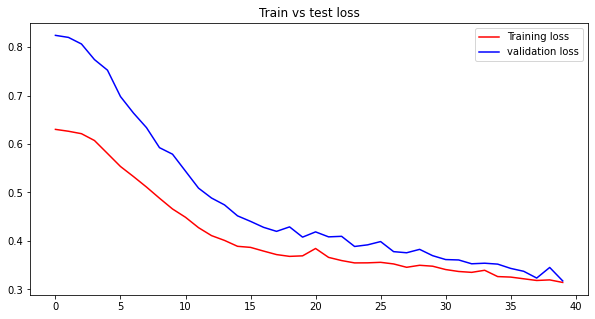

In [ ]:
#plotting train vs test loss
plt.plot(history.history['loss'],label = 'Training loss', color ='r')
plt.plot(history.history['val_loss'],label = 'validation loss', color = 'b')
plt.title('Train vs test loss')
plt.legend()
plt.show()

Anomaly detection where reconstruction loss is more than threshold

array([[0.2198494 ],
       [0.23056329],
       [0.22442125],
       ...,
       [0.3431897 ],
       [0.3411322 ],
       [0.32536452]])

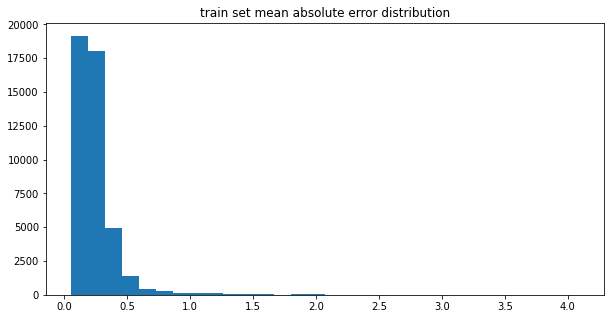

In [ ]:
trainPredict = model.predict(trainX)
trainMAE = np.mean(np.abs(trainPredict-trainX), axis=1)
plt.hist(trainMAE,bins=30)
plt.title('train set mean absolute error distribution')

max_trainMAE = 0.9  #set to about 90% value
trainMAE

array([[0.10943206],
       [0.12283137],
       [0.12083133],
       ...,
       [0.1736455 ],
       [0.17011382],
       [0.15920338]])

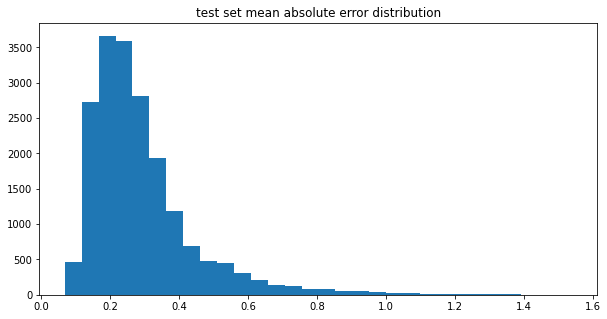

In [ ]:
testPredict = model.predict(testX)
testMAE = np.mean(np.abs(testPredict-testX), axis=1)
plt.hist(testMAE,bins=30)
plt.title('test set mean absolute error distribution')
testMAE

In [ ]:
# anomalous dataframe design
anomaly_df = pd.DataFrame(test[seq_size:])
anomaly_df['testMAE'] = testMAE
anomaly_df['max_trainMAE'] = max_trainMAE
anomaly_df['anomaly'] = anomaly_df['testMAE']>anomaly_df['max_trainMAE']
anomaly_df['az(g)'] = test[seq_size:]['az(g)']
anomaly_df

NameError: ignored

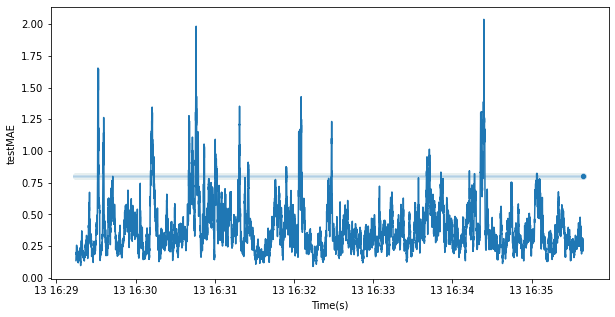

In [ ]:
#plot testMAE vs trainMAE
sns.lineplot(x=anomaly_df.index, y = anomaly_df['testMAE'])
sns.scatterplot(x=anomaly_df.index, y = anomaly_df['max_trainMAE'])



/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



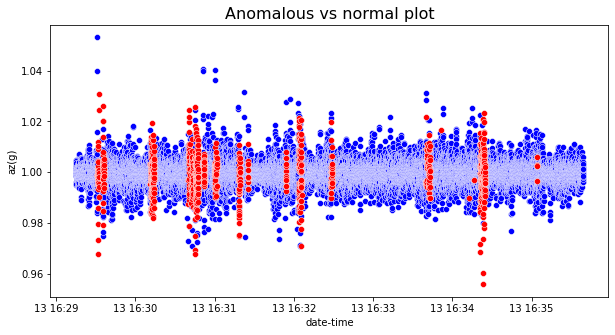

In [ ]:
#plotting the anomalies
import plotly.express as px

anomalies = anomaly_df.loc[anomaly_df['anomaly'] == True]
normal = anomaly_df.loc[anomaly_df['anomaly'] == False]
sns.scatterplot(normal.index, y = scaler.inverse_transform(normal['az(g)']), color = 'blue')
sns.scatterplot(x=anomalies.index, y = scaler.inverse_transform(anomalies['az(g)']), color = 'red')
plt.title("Anomalous vs normal plot", fontsize = 16) # title of scatter plot
plt.xlabel("date-time", fontsize = 10) # x-axis label
plt.ylabel("az(g)", fontsize = 10) # y-axis label
plt.show() 
#fig = px.scatter(x=anomalies.index, y = scaler.inverse_transform(anomalies['az(g)']), color = 'anomaly')
#fig = px.scatter(x=anomaly_df.index, y = scaler.inverse_transform(anomaly_df['az(g)']), color = 'blue')
#fig.show()